# Imports

In [1]:
import os
import sys
from glob import glob
sys.path.append('../src/')

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

from scipy.signal import stft

from data.processing import ( # type: ignore
    load_dat_file,
    length_corrector,
    get_sampling_rate,
    visualize_signal,
    get_stft_spectrogram,
    get_power_spectrogram_db,
    get_color_img,
    add_awgn_noise,
    get_spectrogram,
    save_spectrogram,
)

from data.constants import ( # type: ignore
    FFT_SIZE,
    SAMPLING_RATE,
    CENTER_FREQ,
    NUM_FFT_SPEC,
    RECORDING_TIME,
)

from data.dataset import ( # type: ignore
    save_to_json,
    load_jsonl,
    save_to_jsonl,
    save_processed_data,
    create_folder,
    get_starting_index,
    get_drone_model,
    get_drone_manufacture,
    get_drone_bandwidth,
    get_drone_center_freq,
    get_drone_operation_mode,
    get_drone_info,
    get_samples_from_recording,
    save_samples_from_recording,
    make_dataset,
)

# Load Data

In [2]:
base_path = '../data/Relate work from AeroDefense/Data/Raw data/Rowan_05222025/'
patterns = [f'{base_path}*.dat', f'{base_path}*{os.sep}*.dat']
dat_files = []
[dat_files.extend(glob(pattern)) for pattern in patterns]
dat_files

[]

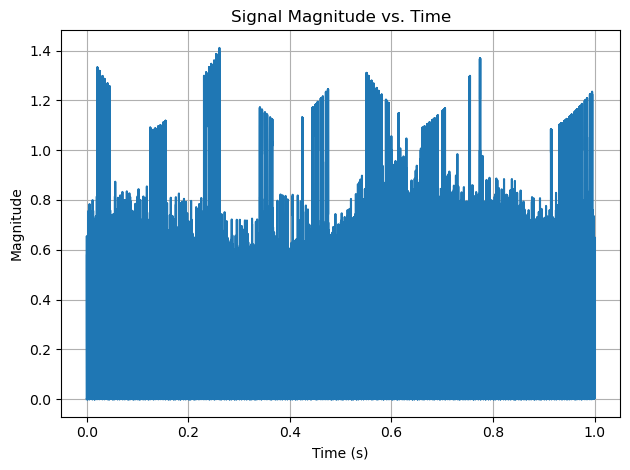

In [15]:
signal = np.memmap(dat_files[2], dtype=np.complex64, mode='r')
signal_sample = signal[:SAMPLING_RATE]
visualize_signal(signal_sample)

In [20]:
1024*1500

1536000

In [23]:
FFT_SIZE = 1024
NUM_FFT_SPEC = 1500
signal = np.memmap(dat_files[2], dtype=np.complex64, mode='r')
i = 100


In [ ]:
step= 1000
signal_sample = signal[int(i*SAMPLING_RATE):int((i+step)*SAMPLING_RATE)]
corrected_sample = length_corrector(signal_sample,FFT_SIZE)
corrected_sample = signal_sample[:NUM_FFT_SPEC*FFT_SIZE if signal_sample.size > NUM_FFT_SPEC*FFT_SIZE else signal_sample]
spectrum, fig = get_spectrogram(corrected_sample)
fig

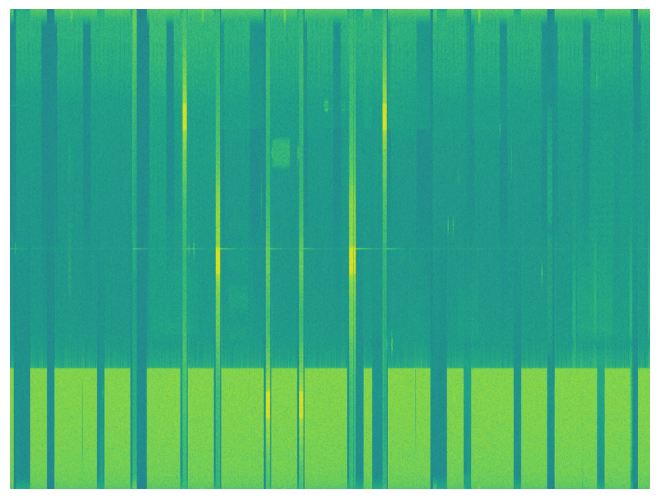

In [7]:
spectrum.shape

(1024, 1142)

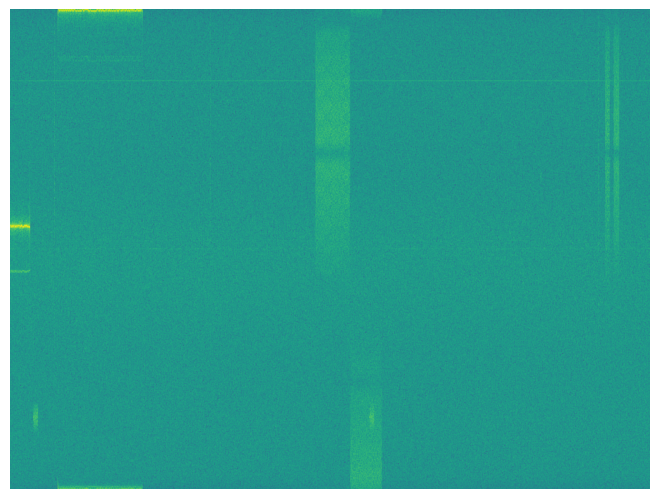

In [8]:
# save_spectrogram(fig, 'test.png', dpi=300, verbose=True, overwrite=True)
fig

In [9]:
spectrum.shape

(1024, 1142)

# Custom Spectogram

In [2]:
base_path = '../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02/'
patterns = [f'{base_path}*.dat', f'{base_path}*{os.sep}*.dat']
dat_files = []
[dat_files.extend(glob(pattern)) for pattern in patterns]
dat_files

['../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02/Metlife_no_event_76_20_5_Y_14 05 04.772657/DJI_Mini3_2412.5_10_2410.5_1_5_on_the_ground_10.dat',
 '../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02/Metlife_no_event_76_20_5_Y_14 05 04.772657/DJI_Mini3_2412.5_10_2400.5_1_5_on_the_ground_10.dat',
 '../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02/Metlife_no_event_76_20_5_Y_14 05 04.772657/DJI_Mini3_2412.5_10_2434.5_1_5_on_the_ground_10.dat',
 '../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02/Metlife_no_event_76_20_5_Y_14 05 04.772657/DJI_Mini3_2412.5_10_2422.5_1_5_on_the_ground_10.dat',
 '../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02/Metlife_no_event_76_20_5_Y_14 05 04.772657/DJI_Mini3_2412.5_10_2420.5_1_5_on_the_ground_10.dat',
 '../data/Relate work from AeroDefense/Data/Raw data/site_survey_recording/2025-07-02

Mini3
Mini3
STFT 1 shape: (1024, 1714)
Merged


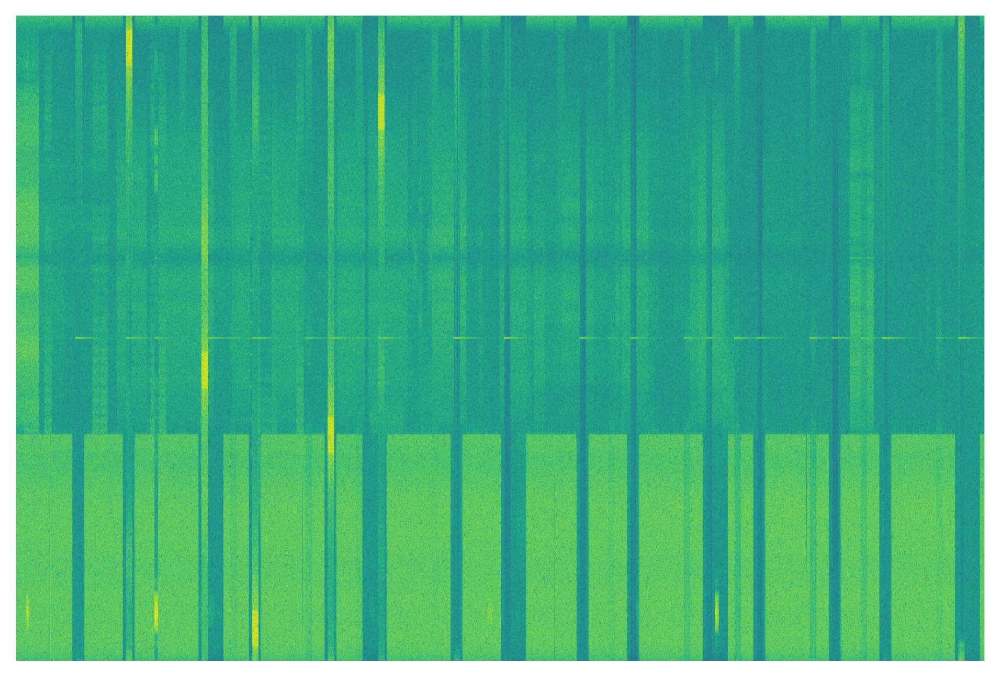

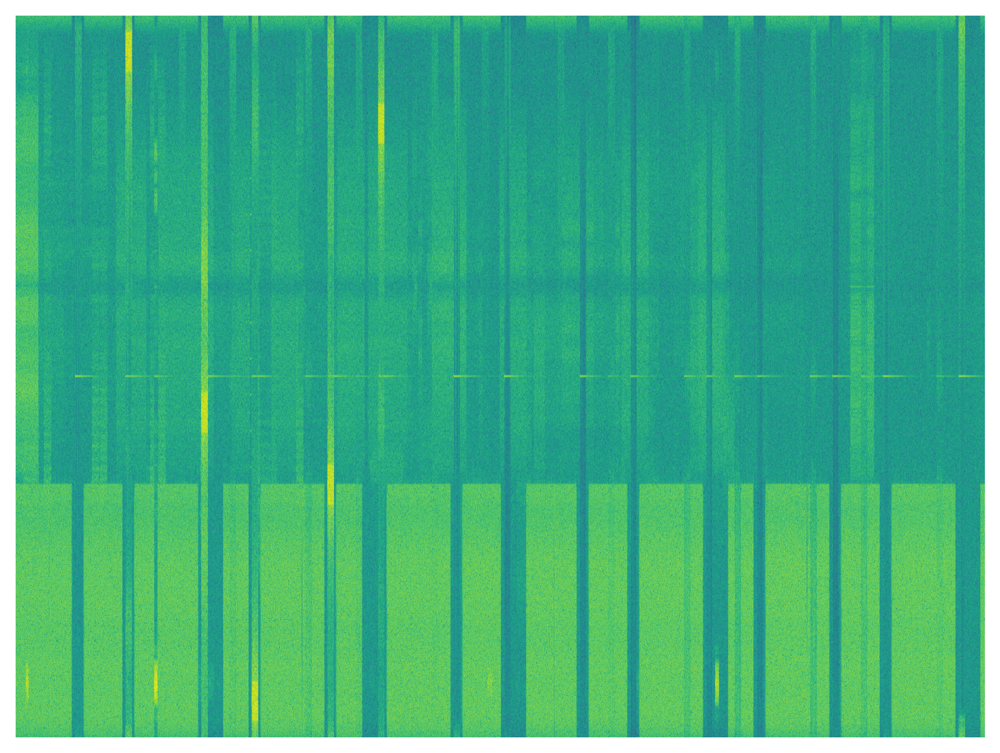

In [4]:
FFT_SIZE = 1024
NUM_FFT_SPEC = 1500
i = 2
signal_1 = np.memmap(dat_files[i], dtype=np.complex64, mode='r')
# signal_2 = np.memmap(dat_files[i+1], dtype=np.complex64, mode='r')

sample_1 = signal_1[:int(0.5*SAMPLING_RATE)]
sample_1 = length_corrector(sample_1, FFT_SIZE)
# print(sample_1.shape)
sample_1 = sample_1[:NUM_FFT_SPEC*FFT_SIZE] if sample_1.size > NUM_FFT_SPEC*FFT_SIZE else sample_1
# _, fig_1 = get_spectrogram(sample_1)
print(get_drone_model(dat_files[i]))
# fig_1, ax = plt.subplots(1, figsize=(6, 4), dpi=300)
# # Remove whitespace around the plot for a cleaner image
# fig_1.subplots_adjust(left=0, right=1, bottom=0, top=1)
# # Generate the spectrogram using matplotlib's specgram function
# spectrum, freqs, t, im = ax.specgram(x=sample_1, Fs=SAMPLING_RATE, NFFT=FFT_SIZE, Fc=get_drone_center_freq(dat_files[i]),)
# # Turn off the axes (labels, ticks) for a pure image representation
# ax.axis('off')

# print(sample_1.shape)



# sample_2 = signal_2[:int(0.5*SAMPLING_RATE)]
# print(sample_2.shape)
# sample_2 = length_corrector(sample_2, FFT_SIZE)
# sample_2 = sample_2[:NUM_FFT_SPEC*FFT_SIZE] if sample_2.size > NUM_FFT_SPEC*FFT_SIZE else sample_2
# print(sample_2.shape)
# _, fig_2 = get_spectrogram(sample_2)
print(get_drone_model(dat_files[i+1]))
fig_2, ax = plt.subplots(1, figsize=(6, 4), dpi=300)
# Remove whitespace around the plot for a cleaner image
fig_2.subplots_adjust(left=0, right=1, bottom=0, top=1)
# Generate the spectrogram using matplotlib's specgram function
spectrum, freqs, t, im = ax.specgram(x=sample_1, #+sample_2,
                                      Fs=SAMPLING_RATE, NFFT=FFT_SIZE, Fc=get_drone_center_freq(dat_files[i+1]),)
# Turn off the axes (labels, ticks) for a pure image representation
ax.axis('off')


# noisy_sample_1 = add_awgn_noise(sample_1, 100)
# _,_,stft_1 = stft(sample_1, fs=1, nperseg=FFT_SIZE, noverlap=128, window= 'hann', return_onesided=False)
# stft_1 = np.fft.fftshift(stft_1, axes=0) # Shift along the frequency axis (axis 0)

stft_1 = get_stft_spectrogram(sample_1, window_size=FFT_SIZE)
# stft_2 = get_stft_spectrogram(sample_2, window_size=FFT_SIZE)


print(f"STFT 1 shape: {stft_1.shape}")
# print(f"STFT 2 shape: {stft_2.shape}")

stft_matrix = stft_1 #+ stft_2

# Calculate specgram
# spectrum = get_power_spectrogram_db(stft_1) + get_power_spectrogram_db(stft_2)
spectrum = get_power_spectrogram_db(stft_matrix)
# print(f"Original spectrum range: {spectrum.min():.1f} to {spectrum.max():.1f} dB")

rgb_image = get_color_img(spectrum, colormap='viridis')
# print(f"RGB image shape: {rgb_image.shape}")
# plt.imsave('test.png', rgb_image, dpi=300, format='png') # cmap is ignored if rgb_image is already RGB/RGBA


# Display the RGB image
print("Merged")
plt.figure(figsize=(8, 6), dpi=300)
plt.imshow(rgb_image, aspect='auto', origin='lower')
# plt.title('Merged STFT Spectrogram')
plt.axis('off')
plt.show()

# print(f"RGB image shape: {rgb_image.shape}")
# print(f"RGB values range: {rgb_image.min():.3f} to {rgb_image.max():.3f}")


# # Create figure and axes
# fig, ax = plt.subplots(figsize=(10, 6))

# im = ax.imshow(
#     spectrum,
#     aspect='auto',
#     origin='lower',
#     cmap='viridis',
# )

# plt.colorbar(im, label='Power/Frequency (dB/Hz)')

# ax.axis('off')  # Hide axes
# plt.show()

# print(f"spectrum shape: {spectrum.shape}")


In [40]:
np.zeros_like(rgb_image) + rgb_image == rgb_image

array([[[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       [[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       [[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       ...,

       [[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       [[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,

Spectrogram shape: (1024, 1716)


(np.float64(-0.5), np.float64(1715.5), np.float64(-0.5), np.float64(1023.5))

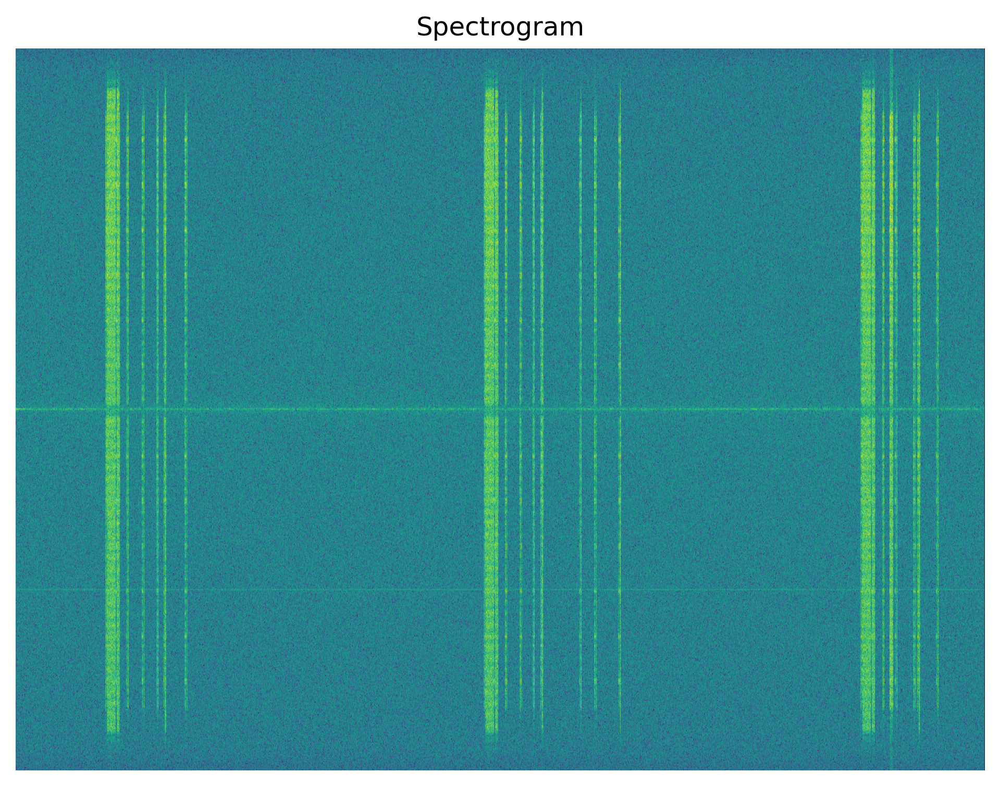

In [32]:
import scipy.signal

_,_, spec = scipy.signal.stft(sample_1, fs=SAMPLING_RATE, nperseg=FFT_SIZE, noverlap=128, window='hann', return_onesided=False)
center_spec = np.fft.fftshift(spec, axes=0)  # Shift along the frequency axis (axis 0)
print(f"Spectrogram shape: {center_spec.shape}")


rgb_image_spec = get_color_img(get_power_spectrogram_db(center_spec), colormap='viridis')

# Display the RGB image for spectrogram
plt.figure(figsize=(8, 6), dpi=300)
plt.imshow(rgb_image_spec, aspect='auto', origin='lower')
plt.title('Spectrogram')
plt.axis('off')


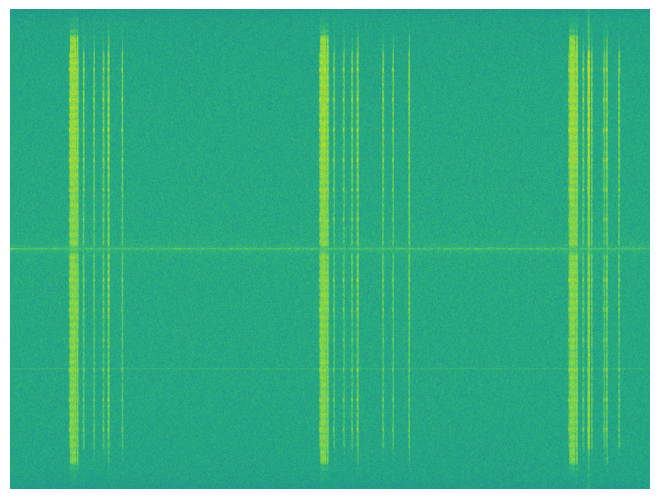

In [34]:
_, fig_1 = get_spectrogram(sample_1)
fig_1

F11GIM


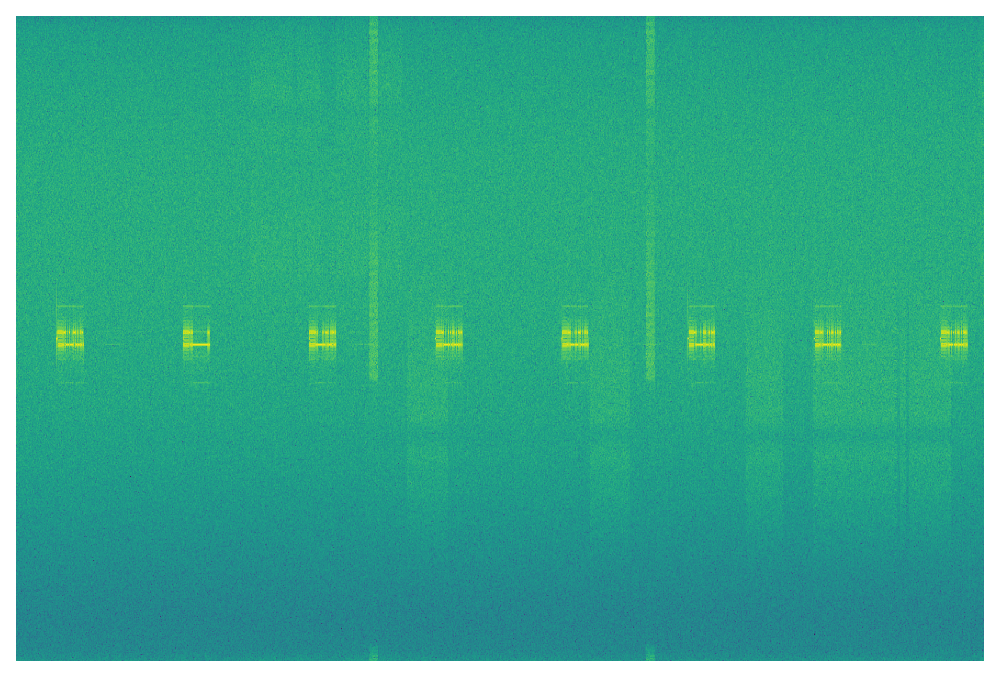

In [13]:
# fig_1.suptitle('Spectrogram of Sample 1')
print(get_drone_model(dat_files[i]))
fig_1

In [14]:
# print(get_drone_model(dat_files[i+1]))
# fig_2

# Sliding Window

In [ ]:
signal = np.arange(0, 10*15, 1)
signal.size

150

In [ ]:
list(range(0, signal.size - 10 + 1, 5))[-10:]

[95, 100, 105, 110, 115, 120, 125, 130, 135, 140]

In [ ]:
samples = get_samples_from_recording(signal, sampling_rate=10, sample_time=0.5, step_time=0.25)
len(list(samples.values()))

73

# Saving

In [ ]:
file_path = dat_files[2]
data = {
		'file_path': file_path,
		'model': get_drone_model(file_path),
		'manufacture': get_drone_manufacture(file_path),
		'bandwidth': get_drone_bandwidth(file_path),
		'center_freq': get_drone_center_freq(file_path),
		'operation_mode': get_drone_operation_mode(file_path)
	}
save_to_jsonl(data, 'test.json')

In [ ]:
# Load the data from the JSON Lines file
jsonl_file_path = 'test.json'
loaded_data = load_jsonl(jsonl_file_path)

# Print the loaded data (optional)
# print(loaded_data)
# print(f"Loaded {len(loaded_data)} records from {jsonl_file_path}")

In [ ]:
loaded_data

[{'file_path': '../data/Relate work from AeroDefense/Data/Raw data/SR20M_G50_cage_RT15/RadioMaster_TX16S_NA_2433.dat',
  'model': 'TX16S',
  'manufacture': 'RadioMaster',
  'bandwidth': 'NA',
  'center_freq': None,
  'operation_mode': ''}]

Found 53 .dat files to process.
Successfully created folder: ./test_dataset


Processing files:   0%|          | 0/53 [00:00<?, ?file/s]

/home/woreom/miniconda3/envs/drone/lib/python3.10/site-packages/matplotlib/axes/_axes.py:8264: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)
Processing files:   2%|▏         | 1/53 [04:09<3:36:37, 249.95s/file]


KeyboardInterrupt: 

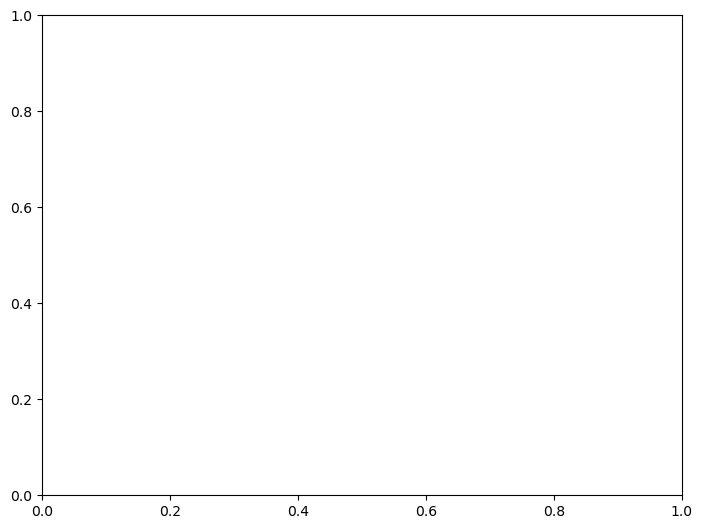

In [19]:
make_dataset(dataset_path='./test_dataset')

In [ ]:
os.path.isdir('test.json')

False

# No Drone

In [ ]:
no_drone_files = glob("../data/Related work from Rowan/no_drone/*.dat")
no_drone_files

['../data/Related work from Rowan/no_drone/NoDrone905_SampRate20MHz.dat',
 '../data/Related work from Rowan/no_drone/NoDrone_Band24GHz_Freq2442_SampRate20MHz_ReqTime30sec-002.dat',
 '../data/Related work from Rowan/no_drone/NoDrone_Band900MHz_Freq918_SampRate20MHz_ReqTime30sec-002.dat',
 '../data/Related work from Rowan/no_drone/NoDrone905_SapmRate10MHz.dat',
 '../data/Related work from Rowan/no_drone/NoDrone2442_SampRate20MHz.dat',
 '../data/Related work from Rowan/no_drone/NoDrone2442_SapmRate10MHz.dat']

In [ ]:
drone_files =glob('../data/Relate work from AeroDefense/Data/Raw data/SR20M_G50_cage_RT15/DJI/*.dat')
drone_files
get_drone_info(drone_files[0])

{'original_file_path': '../data/Relate work from AeroDefense/Data/Raw data/SR20M_G50_cage_RT15/DJI/DJI_FPV_10_2435_not_engaging.dat',
 'model': 'FPV',
 'manufacture': 'DJI',
 'bandwidth': 10,
 'center_freq': 2435,
 'operation_mode': 'not-engaging'}

In [ ]:
dat_file =  '../data/Related work from Rowan/no_drone/NoDrone2442_SampRate20MHz.dat'
sampling_rate = 20000000


signal = load_dat_file(dat_file)
dataset_path = '../data/Related work from Rowan/dataset/'
sample_time = 0.5
step_time = 0.25
fft_size = FFT_SIZE
num_fft_spec = NUM_FFT_SPEC

# Create a temporary metadata file
tmp_metadata_file = os.path.join(dataset_path, 'no_drone_tmp.jsonl')

# Extract drone information from the filename
drone_info = {'original_file_path': dat_file,
            'model': 'no_drone',
            'manufacture': None,
            'bandwidth': None,
            'center_freq': 2442,
            'operation_mode': None}

# Add processing parameters to the drone_info dictionary
drone_info['sampling_rate'] = sampling_rate
drone_info['sample_time'] = sample_time
drone_info['step_time'] = step_time
drone_info['fft_size'] = fft_size
drone_info['num_fft_spec'] = num_fft_spec
# Calculate sample size and step size in data points
drone_info['sample_size'] = int(sample_time * sampling_rate)
drone_info['window_size'] = int(step_time * sampling_rate)

# Define and create the save path specific to the drone model
save_path = os.path.join(dataset_path, str(drone_info['model'])) # Ensure model is string for path
create_folder(folder_path=save_path, verbose=False, overwrite=False) # verbose=False to reduce console clutter

# Process the signal: extract samples, generate spectrograms, save files, and log metadata
save_samples_from_recording(
    signal,
    save_path,
    drone_info,
    file_pattern='sample',
    tmp_file=tmp_metadata_file
)

In [ ]:
# Finalize metadata: load from tmp file and save to final JSON file
final_metadata_file = os.path.join(dataset_path, 'no_drone_meta_data.json')
meta_data = []
print(f"Loading metadata from temporary file: {tmp_metadata_file}")
meta_data = load_jsonl(tmp_metadata_file)
if meta_data:
    print(f"Saving final metadata ({len(meta_data)} entries) to: {final_metadata_file}")
    save_to_json(meta_data, final_metadata_file)
else:
    print("Warning: Temporary metadata file was empty or failed to load.")

# Clean up the temporary file
try:
    os.remove(tmp_metadata_file)
    print(f"Removed temporary metadata file: {tmp_metadata_file}")
except OSError as e:
    print(f"Warning: Could not remove temporary metadata file {tmp_metadata_file}: {e}")

Loading metadata from temporary file: ../data/Related work from Rowan/dataset/no_drone_tmp.jsonl
Saving final metadata (652 entries) to: ../data/Related work from Rowan/dataset/no_drone_meta_data.json
Removed temporary metadata file: ../data/Related work from Rowan/dataset/no_drone_tmp.jsonl


In [ ]:
import json # Standard library for JSON manipulation

# Path to the JSON file that will be modified (appended to)
# This uses the existing 'final_metadata_file' variable from the notebook context.
file_to_modify = os.path.join(dataset_path, 'meta_data.json')

# Path to the JSON file whose content will be added.
# For demonstration, we'll create this file in the 'dataset_path'.
# In a real scenario, this file would already exist.
file_with_data_to_add_path = os.path.join(dataset_path, 'no_drone_meta_data.json')

# 1. Load existing data from the file to be modified
existing_data = []
try:
    with open(file_to_modify, 'r') as f:
        loaded_content = json.load(f)
    # Ensure it's a list, as we expect a JSON array of records
    if isinstance(loaded_content, list):
        existing_data = loaded_content
    else:
        print(f"Warning: Data in {file_to_modify} is not a list. Initializing as empty list for appending.")
except FileNotFoundError:
    print(f"Warning: {file_to_modify} not found. Will create it if new data is added.")
except json.JSONDecodeError:
    print(f"Warning: Could not decode JSON from {file_to_modify}. Starting with an empty list.")
existing_data
# 2. Load data from the file to be added
data_to_add = []
try:
    with open(file_with_data_to_add_path, 'r') as f:
        loaded_content_to_add = json.load(f)
    if isinstance(loaded_content_to_add, list):
        data_to_add = loaded_content_to_add
    else:
        print(f"Warning: Data in {file_with_data_to_add_path} is not a list. These entries will not be appended.")
except FileNotFoundError:
    print(f"Warning: Source file {file_with_data_to_add_path} not found. No data to add.")
except json.JSONDecodeError:
    print(f"Warning: Could not decode JSON from {file_with_data_to_add_path}. No data to add.")
data_to_add

file_to_modify = os.path.join(dataset_path, 'all_meta_data.json')
# 3. Append the new data to the existing data
if data_to_add:  # Only proceed if there's valid data to add
    existing_data.extend(data_to_add)

    # 4. Save the combined data back to the original file (file_to_modify)
    # This overwrites 'file_to_modify' with the combined list of records.
    save_to_json(existing_data, file_to_modify)
    print(f"Successfully appended data from '{file_with_data_to_add_path}' to '{file_to_modify}'.")
    print(f"'{file_to_modify}' now contains {len(existing_data)} records.")
else:
    print(f"No valid data found in '{file_with_data_to_add_path}' to append, or target file issues prevented loading.")


Successfully appended data from '../data/Related work from Rowan/dataset/no_drone_meta_data.json' to '../data/Related work from Rowan/dataset/all_meta_data.json'.
'../data/Related work from Rowan/dataset/all_meta_data.json' now contains 4082 records.


In [49]:
no_drone_files = [
			'../data/Relate work from AeroDefense/Data/Raw data/NoDrone_indoor/NoDrone_Band24GHz_Freq2442_SampRate20MHz_ReqTime30sec-002.dat',
			'../data/Relate work from AeroDefense/Data/Raw data/NoDrone_indoor/NoDrone_Band900MHz_Freq918_SampRate20MHz_ReqTime30sec-002.dat',
			'../data/Relate work from AeroDefense/Data/Raw data/NoDrone_outdoor/NoDrone905_SampRate20MHz.dat',
			'../data/Relate work from AeroDefense/Data/Raw data/NoDrone_outdoor/NoDrone2442_SampRate20MHz.dat'
		]


def extract_numeric_info_from_filename(file_path: str) -> int:
    """
    Parses a filename to extract an integer associated with 'Freq' or 'NoDrone'.

    Args:
        file_path: The full path to the file.

    Returns:
        An integer if a numeric part associated with 'Freq' or 'NoDrone'
        is found, otherwise None.
    """
    base_name = os.path.basename(file_path)
    name_without_ext = os.path.splitext(base_name)[0]
    
    parts = name_without_ext.split('_')
    
    for part_str in parts:
        if 'Freq' in part_str:
            numeric_candidate_str = part_str.replace('Freq', '')
            try:
                return int(numeric_candidate_str)
            except ValueError:
                # If 'Freq' is present but not followed by a valid int,
                # continue searching in other parts.
                pass
        elif 'NoDrone' in part_str:
            numeric_candidate_str = part_str.replace('NoDrone', '')
            try:
                return int(numeric_candidate_str)
            except ValueError:
                # If 'NoDrone' is present but not followed by a valid int (e.g. "NoDroneABC" or just "NoDrone"),
                # continue searching in other parts.
                pass
                
    return None


for file_path in no_drone_files:
    extracted_info = extract_numeric_info_from_filename(file_path)
    print(extracted_info)
    # else:
    #     print(f"No numeric info found for {os.path.basename(file_path)}")


2442
918
905
2442
